![title](LogoEPL.jpg)
<b><p style='text-align: center;'> Algorithms in Data Science  </p> </b>

<b><p style='text-align: center;'> London Transport System Study </p> </b>
<b><p style='text-align: center;'> Commuters data from November 2009 </p> </b>

<i><p style='text-align: Center;'> Nima Farnoodian , Charles Rongione, Breno Tiburico</p> </i>

# <u> Importing libraries</u>

Besides the TFL dataset containing the journey information, we have considered two another datasets:

a) <u>London Station</u>: information about the latitude and longitude of all the station so we can calculate the distances between the stations that are connected.

b) <u>London Tubes lines</u>: information about the physical edges between stations.



In [186]:
import pandas as pd 
import numpy as np 
import scipy.stats as sc
from math import sin, cos, sqrt, atan2, radians
from collections import defaultdict 
import folium
import networkx as nx
import csv
import matplotlib
import matplotlib.pyplot as plt
from ast import literal_eval
from itertools import chain

from ipywidgets import interact, interact_manual

import folium
from math import sin, cos, sqrt, atan2, radians
from folium import plugins
from folium.plugins import FloatImage


import pickle
#import geopandas as gpd
import os
import random

import ipywidgets as widgets

# <u>Importing datasets</u>

Besides the TFL dataset containing the journey information, we have considered two another datasets:

a) <u>London Station</u>: information about the latitude and longitude of all the station so we can calculate the distances between the stations that are connected.

b) <u>London Tubes lines</u>: information about the physical edges between stations.

In [148]:
###########
# Journey
###########

#Nov09JnyExport
tfl_data = pd.read_csv('Journey_Matched.csv')
df = tfl_data.copy()

# delete unstarted for StartStn & EndStation and LTB
df = df[df.StartStn != 'Unstarted']
df = df[df.EndStation != 'Unfinished']
df = df[df.StartStn != df.EndStation]
df = df[df.SubSystem != 'LTB']

############
# Auxiliary
############

#London location
location = pd.read_csv('London_stations_matched.csv')
location = location.set_index('Station')

#London tube lines
tube = pd.read_csv('tube_matched.csv')

# df.info()
# locations.info()
location.head()



,OS X,OS Y,Latitude,Longitude,Zone,Postcode
Station,,,,,,
abbey-road,539081,183352,51.531952,0.003723,3,E15 3NB
abbey-wood,547297,179002,51.490784,0.120272,4,SE2 9RH
acton-central,520613,180299,51.508758,-0.263430,2,W3 6BH
acton-main-line,520296,181196,51.516887,-0.267690,3,W3 9EH
acton-town,519457,179639,51.503071,-0.280303,3,W3 8HN


## <u>Functions</u>

In [149]:
####################
# Functions
####################

# Creating Map
def LineDrawer(location, tubes, m):
    import matplotlib
   
    color_dict = {}
    for i, j in zip(list(matplotlib.colors.cnames.items()), tube['Tube Line'].unique()):
        color_dict[j] = i[0]
   
   
    for fro, to, line in zip(tubes['From Station'], tubes['To Station'], tubes['Tube Line']):
                        
            Lat_from = location.loc[fro]['Latitude']
            Long_from = location.loc[fro]['Longitude']
                        
            start = [Lat_from, Long_from]
                        
   
            Lat_to = location.loc[to]['Latitude']
            Long_to = location.loc[to]['Longitude']
                        
            end = [Lat_to, Long_to]
   
            folium.PolyLine(locations = [start, end], color = color_dict[line], smoot_factor = 5, opacity = 0.5).add_to(m)
            #plugins.AntPath([start, end]).add_to(m)

# Using shortest_path attribute from nx
def journey_att(G, source, target, extime, entime):
    path_ = nx.shortest_path(G, source=source,target =target, weight='dist')
    distance=0
    for idx in range(len(path_)-1):
        source=path_[idx]
        target=path_[idx+1]
        distance+=G[source][target]['dist']
    avg_speed=np.round((distance*60)/(extime-entime),2)     
    
    for idx in range(len(path_)-1):
        source=path_[idx]
        target=path_[idx+1]
        G[source][target]['avg_speeds'].append(avg_speed)
        G[source][target]['passengers']+= 1
       
    
    return distance, len(path_)-1, path_

# candle bar chart
def colored_Box(data, classes, feature, color_scale, class_column):
    traces = []
    for i in range(len(classes)):
        idx = data[class_column] == classes[i]
        class_trace = go.Box(
            y = data[idx][feature].values,
            name="class {}".format(classes[i]),
            boxpoints='suspectedoutliers',
            boxmean='sd',
            marker=dict(
                color=color_scale[i],
                outliercolor='rgba(255, 221, 23, 0.6)',
            )
        )
        traces.append(class_trace)
    return traces

# Range Weekdays for aggregation.
def DayRange(row):
    if row['Weekday'] == 'Mon':
        return 'Mon-Fri'
    if row['Weekday'] == 'Tue' :
        return 'Mon-Fri'
    if row['Weekday'] == 'Wed' :
        return 'Mon-Fri'
    if row['Weekday'] == 'Thu':
        return 'Mon-Fri'
    if row['Weekday']  == 'Fri':
        return 'Mon-Fri'
    if row['Weekday']  == 'Sat':
        return 'Sat-Sun'
    if row['Weekday']  == 'Sun':
        return 'Sat-Sun'

    
def Percentilizer(df_to_subset, parameter_to_evaluate):
   
    p = parameter_to_evaluate
    test_df = df_to_subset
    
    
    test_df_90 = test_df[(test_df[p] >= np.percentile(test_df[p], 90))]
    test_df_80 = test_df[(test_df[p] >= np.percentile(test_df[p], 80)) & ((test_df[p] < np.percentile(test_df[p], 90)))]
    test_df_70 = test_df[(test_df[p] >= np.percentile(test_df[p], 70)) & ((test_df[p] < np.percentile(test_df[p], 80)))]
    test_df_60 = test_df[(test_df[p] >= np.percentile(test_df[p], 60)) & ((test_df[p] < np.percentile(test_df[p], 70)))]
    test_df_50 = test_df[(test_df[p] >= np.percentile(test_df[p], 50)) & ((test_df[p] < np.percentile(test_df[p], 60)))]
    test_df_40 = test_df[(test_df[p] >= np.percentile(test_df[p], 40)) & ((test_df[p] < np.percentile(test_df[p], 50)))]
    test_df_30 = test_df[(test_df[p] >= np.percentile(test_df[p], 30)) & ((test_df[p] < np.percentile(test_df[p], 40)))]
    test_df_20 = test_df[(test_df[p] >= np.percentile(test_df[p], 20)) & ((test_df[p] < np.percentile(test_df[p], 30)))]
    test_df_10 = test_df[(test_df[p] >= np.percentile(test_df[p], 10)) & ((test_df[p] < np.percentile(test_df[p], 20)))]
    test_df_00 = test_df[(test_df[p] <= np.percentile(test_df[p], 10))]
    

    df_list = (test_df_90, test_df_80, test_df_70, test_df_60, test_df_50, test_df_40, test_df_30, test_df_20, test_df_10, test_df_00)
    
    return df_list

def LineDrawer2(location, tubes, m, color):
    
    for fro, to in zip(tubes['station1'], tubes['station2']):
                         
        Lat_from = location.loc[fro]['Latitude']
        Long_from = location.loc[fro]['Longitude']

        start = [Lat_from, Long_from]

        Lat_to = location.loc[to]['Latitude']
        Long_to = location.loc[to]['Longitude']

        end = [Lat_to, Long_to]

        folium.PolyLine(locations = [start, end], smoot_factor = 5, opacity = 4, color = color).add_to(m)


#def journey_analysis(df,common_num_feature,discriminative,values_disc):

# <u> Journey's Network and Communities </u>

## Guidelines: 

a. Plot Overall System Network (400026)

b. Subsystem Networks: 

b1. LUL >>> LU, LUL/NR,LUL/DLR, LUL/NR/LRC, LUL/NR/DLR, LUL/LRC, LUL/TRAM (356.107)

b2. NR >>> NR, LUL/NR, LUL/NR/LRC, NR/LRC, LUL/NR/DLR, NR/DLR (52.480) 
 
b3. DLR >>> LUL/DLR, DLR, LUL/NR/DLR, NR/DLR, DLR/LRC (11.642)

b4. LRC >>> LUL/NR/LRC,	NR/LRC,	LRC, LUL/LRC, DLR/LRC (9.233) 

c. Day of week

c1. By workdays

c2. By weekend


## Generating the Network

In [150]:
file  = open('tube_matched.csv', "r", encoding='utf8')
a=file.readlines()
G=nx.Graph()
for i in a[1:]:
    i=i[:-1]
    i=i.split(',')
    G.add_edge(i[2],i[3],dist=float(i[4]))  
    G.add_edge(i[2],i[3],passengers=0)
    G.add_edge(i[2],i[3],avg_speeds=[])
    
      
# Net with attribute children for agregations
#     G[][],weekend= 
#         G[][], hour=
#             G.add_edge(i[2],i[3],passengers=0) 
#             G.add_edge(i[2],i[3],avg_speeds=[])
#     G[][],workday=
#         G[][], hour=
#             G.add_edge(i[2],i[3],passengers=0) 
#             G.add_edge(i[2],i[3],avg_speeds=[])
    
print(G['acton-town'])
edlist=[]
for ed in G.edges():
     if 'acton-town' in ed:
            edlist.append(ed)
print(edlist)

{'ealing-common': {'dist': 0.928511805, 'passengers': 0, 'avg_speeds': []}, 'chiswick-park': {'dist': 1.301416478, 'passengers': 0, 'avg_speeds': []}, 'south-ealing': {'dist': 1.858066494, 'passengers': 0, 'avg_speeds': []}, 'turnham-green': {'dist': 1.989020902, 'passengers': 0, 'avg_speeds': []}}
[('acton-town', 'ealing-common'), ('acton-town', 'chiswick-park'), ('acton-town', 'south-ealing'), ('acton-town', 'turnham-green')]


In [151]:
# filter df so you can partially load the network with informations you desire


for index, values in df.iterrows(): 
    trip = journey_att(G=G,source=values[4],target=values[5],extime=values[8], entime=values[6])


print(G.edges(data=True))

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



## <u>Identifying Journeys Step-Stations</u>

In [38]:
df_j=pd.read_csv('Journey_Matched_Bystation.csv')

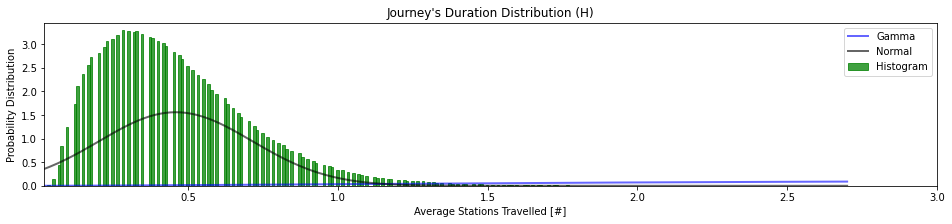

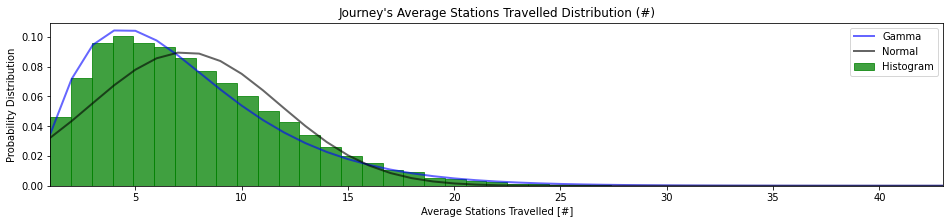

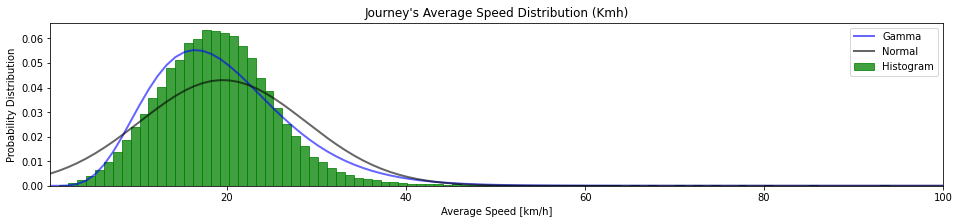

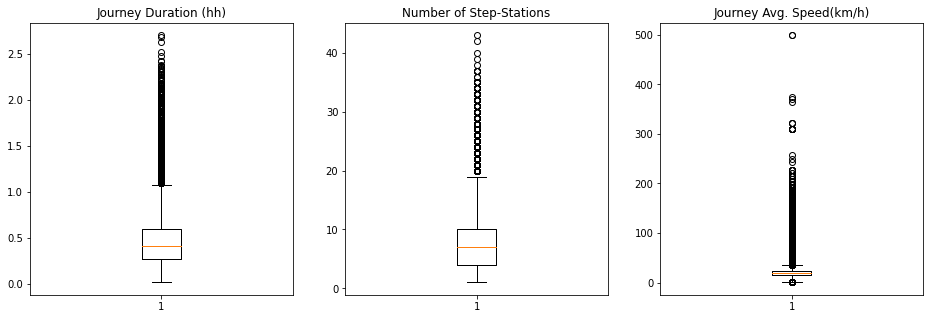

In [152]:
# table all edges with average speed, passengers, daytype, time, 

# Values range:
stations = df_j['stations_count'].values
distance = df_j['journey_dist(km)'].values
time = df_j['journey_dur(hh)'].values
speed = df_j['journey_avgspeed(km/h)'].values #beacuse we have the sense of efficiency. 
                                            #Station have different distances, therefore, time is not a universal metric. 

#Journey's Average Time duration
plt.figure(figsize=(16,3))
x  = np.linspace(min(time),max(time),300)
gamma = sc.gamma.fit(data=stations, floc=0)
g_time = sc.gamma.pdf(x,a=gamma[0],scale=gamma[2])
plt.plot(x, g_time,'b-', lw=2, alpha=0.6, label='Gamma pdf')
plt.plot(x, sc.norm.pdf(x,loc=np.mean(time),scale=np.std(time)),'k-', lw=2, alpha=0.6, label='Norm pdf')
plt.hist(time, 300, density=1,facecolor='g', alpha=0.75,edgecolor='g')
axes = plt.gca()
axes.set_xlim([min(time),3])
plt.title("Journey's Duration Distribution (H)")
plt.xlabel("Average Stations Travelled [#]")
plt.ylabel("Probability Distribution")
plt.legend(['Gamma','Normal','Histogram'])
plt.show()

# Step-stations distribution
plt.figure(figsize=(16,3))
x  = np.linspace(min(stations),max(stations),43)
gamma = sc.gamma.fit(data=stations, floc=0)
g_stations = sc.gamma.pdf(x,a=gamma[0],scale=gamma[2])
plt.plot(x, g_stations,'b-', lw=2, alpha=0.6, label='Gamma pdf')
plt.plot(x, sc.norm.pdf(x,loc=np.mean(stations),scale=np.std(stations)),'k-', lw=2, alpha=0.6, label='Norm pdf')
plt.hist(stations, 43, density=1,facecolor='g', alpha=0.75,edgecolor='g')
axes = plt.gca()
axes.set_xlim([min(stations),43])
plt.title("Journey's Average Stations Travelled Distribution (#)")
plt.xlabel("Average Stations Travelled [#]")
plt.ylabel("Probability Distribution")
plt.legend(['Gamma','Normal','Histogram'])
plt.show()

# Journey's Average Speed distribution
plt.figure(figsize=(16,3))
x  = np.linspace(min(speed),max(speed),500)
gamma = sc.gamma.fit(data=speed, floc=0)
g_speed = sc.gamma.pdf(x,a=gamma[0],scale=gamma[2])
plt.plot(x, g_speed,'b-', lw=2, alpha=0.6, label='Gamma pdf')
plt.plot(x, sc.norm.pdf(x,loc=np.mean(speed),scale=np.std(speed)),'k-', lw=2, alpha=0.6, label='Norm pdf')
plt.hist(speed, 500, density=1,facecolor='g', alpha=0.75,edgecolor='g')
axes = plt.gca()
axes.set_xlim([min(speed),100])
plt.title("Journey's Average Speed Distribution (Kmh)")
plt.xlabel("Average Speed [km/h]")
plt.ylabel("Probability Distribution")
plt.legend(['Gamma','Normal','Histogram'])
plt.show()


plt.figure(figsize=(16,5))

plt.subplot(131)
plt.title("Journey Duration (hh)")
plt.boxplot(time)


plt.subplot(132)
plt.title("Number of Step-Stations")
plt.boxplot(stations)

plt.subplot(133)
plt.title("Journey Avg. Speed(km/h)")
plt.boxplot(speed)

plt.show()



## <u>Breaking Dataframe Down to Step-Stations</u>

<u> Statistic </u>

1) ADD TWO COLUMNS NUMBER & LIST OF STATIONS # Calculate the shortest-stations path between jorney's "Start" and "Destination"


2) ADD COLUMN APPROXIMATE DISTANCE # Calculate "approximate real distance" between "Start" and "Destination" (5, ['Baker Street', 'Bond Street', 'Green Park', 'Westminster', 'Waterloo']) = SUM of Dist


3) ADD COLUMN AVERAGE SPEED PER JOURNEY # Calculate "approximate real distance" between "Start" and "Destination"
Explain better

4) CREATE NEW DF WITH SEGMENTS BETWENN STATIONS WITH INFORMATIONS FOR EACH:

- Row:  Day of the week
- Row:  Day of the week
- Row:  Time of the Day
- Row:  Period of the Day
- Row:  STATAION1 
- Row:  STATION2
- Col:  Speed  (Mean, Std, Variation, Outliers, QuartilesHigher Peak, Lower Peak)
- Col:  Volume (Mean, Std, Variation, Outliers, Higher Peak, Lower Peak) 
- Col: Type of ticket (JNYTYP, FinalProduct, DFare)



In [153]:
for ed in G.edges():
     if 'acton-town' in ed:
            edlist.append(ed)
print(edlist)

[('acton-town', 'ealing-common'), ('acton-town', 'chiswick-park'), ('acton-town', 'south-ealing'), ('acton-town', 'turnham-green'), ('acton-town', 'ealing-common'), ('acton-town', 'chiswick-park'), ('acton-town', 'south-ealing'), ('acton-town', 'turnham-green')]


## <u> Stations Map </u>

In [65]:
 #Shortest path station list
lat_center, long_center = location[['Latitude', 'Longitude']].mean()

map_circle = folium.Map(location=[lat_center, long_center], zoom_start=10,  control_scale=True)


for i,j in zip(location['Latitude'], location['Longitude']):

    folium.CircleMarker(location=[i, j], radius=1, color='blue', fill_color='blue').add_to(map_circle)

LineDrawer(location = location, tubes = tube, m = map_circle)
map_circle

In [157]:
G.edges(data=True)

EdgeDataView([('baker-street', 'regents-park', {'dist': 0.803591111, 'passengers': 653, 'avg_speeds': [15.58, 15.94, 17.84, 18.12, 19.45, 18.69, 13.0, 13.41, 17.22, 16.88, 9.51, 10.75, 11.92, 19.07, 21.43, 10.59, 25.86, 21.99, 24.83, 19.21, 26.09, 16.61, 22.78, 16.08, 17.63, 23.41, 22.18, 24.79, 20.07, 16.52, 10.86, 18.06, 6.03, 13.0, 17.84, 15.95, 19.07, 13.0, 19.15, 8.45, 18.12, 16.86, 14.76, 17.15, 19.66, 20.13, 16.9, 14.69, 15.92, 21.88, 21.75, 15.89, 12.78, 18.12, 19.21, 13.76, 33.63, 18.94, 16.4, 9.65, 15.58, 12.89, 16.4, 9.53, 20.25, 21.28, 39.87, 9.69, 20.43, 13.0, 15.95, 17.12, 19.16, 14.97, 8.45, 13.0, 16.4, 17.04, 9.5, 19.13, 20.25, 13.0, 11.0, 13.0, 12.75, 13.46, 16.88, 18.12, 13.0, 15.58, 11.92, 22.23, 17.22, 16.08, 17.23, 19.21, 14.45, 12.75, 17.88, 15.42, 14.3, 14.35, 8.45, 14.93, 14.28, 13.0, 34.64, 20.37, 11.92, 6.03, 18.26, 35.26, 14.36, 14.97, 12.36, 6.03, 15.38, 39.09, 14.3, 39.04, 15.58, 15.98, 16.65, 16.57, 13.5, 14.85, 24.44, 20.56, 15.89, 15.58, 19.85, 17.84, 15

In [164]:

edges_list = list(G.edges(data=True))

station1=[]
station2=[]
passengers=[]
avg_speeds=[]

for i in range(len(edges_list)):
    station1.append(edges_list[i][0])
    station2.append(edges_list[i][1])
    passengers.append(edges_list[i][2]['passengers'])
    avg_speeds.append(np.mean(edges_list[i][2]['avg_speeds']))
    


dict = {'station1': station1, 'station2': station2, 'passengers': passengers, 'avg_speeds': avg_speeds} 

df_map = pd.DataFrame(dict) 

df_map=df_map.fillna(0)

image_file = 'legend.png'
list_variable = Percentilizer(df_to_subset = df_map, parameter_to_evaluate = 'passengers')
color_list = ['#00ff00', '#80ff00', '#aaff00', '#d5ff00', '#ffff00', '#ffd500', '#ffaa00', '#ff8000', '#ff5500', '#ff0000']
color_list.reverse()

# create the map
lat_center, long_center = location[['Latitude', 'Longitude']].mean()
map_circle = folium.Map(location=[lat_center, long_center], zoom_start=10,  control_scale=True)

for station, c in zip(list_variable, color_list):

    LineDrawer2(location = location, tubes = station, m = map_circle, color = c)
    FloatImage(image_file, bottom=68, left=91).add_to(map_circle)
    
    
map_circle



In [242]:
df_map['segment']=df_map['station1'].astype(str)+" -> "+df_map['station2'].astype(str)

edges=df_map['segment'].values
print(edges[0])

baker-street -> regents-park


In [243]:
myFeatures = widgets.SelectMultiple(
    options= edges,
    value = [edges[0]],
    description='Segments',
    rows = 6,
    disabled=False
)

In [246]:
def single_analysis(df_map,selected_segment):
    # dataframe, 'column choosen', 'raintomorrow', 'raintomorrow'.unique
    
    
    
    print(df_map)
    df_map = df_map[df_map.segment == selected_segment]
    
    print(df_map)
    
    
    speed=df_map['avg_speeds'].values
    passengers=df_map['passengers'].values
    
    print(' ')
    print(' => Descriptive Statistics (whole feature + by class)')
    print(' ----------------------------------------------------')
    print(' ')
    print('overall stats. from data')
    
    # @edit here implement the search for descriptive statistics using stats.describe()

    print(speed)
    
    print(sc.describe(speed))
    print(sc.describe(passengers))
    
    for value in values_disc: # for Yes & No
        print('overall stats. from data for '+str(value)+' instances')
        # @edit here implement the search for descriptive statistics but only for 
        # records within the class value 
       
        print(sc.describe(df[df[discriminative]==value][common_num_feature]))
        

    box_plot_traces = colored_Box(
        data = df_map,
        classes = [speed,passengers],
        feature = selected_segment,
        color_scale = ['green','red','blue','black','yellow','orange','purple','magenta'][:len(values_disc)],
        

    )
    
    fig = dict(data = box_plot_traces)
    iplot(fig) 
    
    ttest = stats.ttest_ind(samples1, samples2, axis=0, equal_var=True, nan_policy='propagate')
    welch_p_value = ttest[1]
    
    print('')
    print('STATEMENT => The Samples1 and Samples2 have different means. <= wrong with (estimated) probability : p = '+"{:.2e}".format(welch_p_value))

def multiple_analysis(selected_segment):
    print(selected_segment)
    single_analysis(df_map,selected_segment);


interact(multiple_analysis, selected_segment=myFeatures )

interactive(children=(SelectMultiple(description='Segments', index=(0,), options=('baker-street -> regents-par…

<function __main__.multiple_analysis(selected_segment)>

# Conclusions

COnclusion based on our statistic resuls.